# Correlation in Python (Movie Data Set)

In [3]:
#Importing Libraries
import pandas as pd
import numpy as np
import seaborn as sns

import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
import matplotlib
plt.style.use('ggplot')
from matplotlib.pyplot import figure

%matplotlib inline
matplotlib.rcParams['figure.figsize'] = (11,8) #Initializing size for all figures

pd.options.mode.chained_assignment = None

### Loading the dataset

In [4]:
#Loading the dataset
df = pd.read_csv(r'C:\Users\lenovo\Downloads\movies.csv')

In [63]:
pd.set_option('display.max.rows',7668)
pd.set_option('display.max.columns',15)

### Understanding the dataset

In [5]:
#Checking what percentage of missing values are in the dataset
for col in df.columns:
    pct_missing = np.mean(df[col].isnull())
    print('{} - {}%'.format(col, round(pct_missing*100)))

name - 0%
rating - 1%
genre - 0%
year - 0%
released - 0%
score - 0%
votes - 0%
director - 0%
writer - 0%
star - 0%
country - 0%
budget - 28%
gross - 2%
company - 0%
runtime - 0%


In [114]:
#Checking datatypes for each column
df.dtypes

name         object
rating       object
genre        object
year          int64
released     object
score       float64
votes       float64
director     object
writer       object
star         object
country      object
budget        int64
gross         int64
company      object
runtime     float64
dtype: object

In [134]:
#Adding a column for released year
df['Year'] = df['released'].astype(str).str[4:]

,name,rating,genre,year,score,votes,director,writer,star,country,budget,gross,company,runtime,Year
0,The Shining,R,Drama,1980,8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000.0,4.699877e+07,Warner Bros.,146.0,"13, 1980 (United States)"
1,The Blue Lagoon,R,Adventure,1980,5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000.0,5.885311e+07,Columbia Pictures,104.0,"2, 1980 (United States)"
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000.0,5.383751e+08,Lucasfilm,124.0,"20, 1980 (United States)"
3,Airplane!,PG,Comedy,1980,7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000.0,8.345354e+07,Paramount Pictures,88.0,"2, 1980 (United States)"
4,Caddyshack,R,Comedy,1980,7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000.0,3.984634e+07,Orion Pictures,98.0,"25, 1980 (United States)"
5,Friday the 13th,R,Horror,1980,6.4,123000.0,Sean S. Cunningham,Victor Miller,Betsy Palmer,United States,550000.0,3.975460e+07,Paramount Pictures,95.0,"9, 1980 (United States)"
6,The Blues Brothers,R,Action,1980,7.9,188000.0,John Landis,Dan Aykroyd,John Belushi,United States,27000000.0,1.152299e+08,Universal Pictures,133.0,"20, 1980 (United States)"
7,Raging Bull,R,Biography,1980,8.2,330000.0,Martin Scorsese,Jake LaMotta,Robert De Niro,United States,18000000.0,2.340243e+07,Chartoff-Winkler Productions,129.0,"mber 19, 1980 (United States)"
8,Superman II,PG,Action,1980,6.8,101000.0,Richard Lester,Jerry Siegel,Gene Hackman,United States,54000000.0,1.081857e+08,Dovemead Films,127.0,"19, 1981 (United States)"
9,The Long Riders,R,Biography,1980,7.0,10000.0,Walter Hill,Bill Bryden,David Carradine,United States,10000000.0,1.579519e+07,United Artists,100.0,"16, 1980 (United States)"


### Cleaning the dataset

In [111]:
#Removing duplicate rows
df.drop_duplicates()

,name,rating,genre,year,released,score,votes,...,star,country,budget,gross,company,runtime,Year
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,...,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146.0,"13, 1980 (United States)"
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,...,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104.0,"2, 1980 (United States)"
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,...,Mark Hamill,United States,18000000,538375067,Lucasfilm,124.0,"20, 1980 (United States)"
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,...,Robert Hays,United States,3500000,83453539,Paramount Pictures,88.0,"2, 1980 (United States)"
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,...,Chevy Chase,United States,6000000,39846344,Orion Pictures,98.0,"25, 1980 (United States)"
5,Friday the 13th,R,Horror,1980,"May 9, 1980 (United States)",6.4,123000.0,...,Betsy Palmer,United States,550000,39754601,Paramount Pictures,95.0,"9, 1980 (United States)"
6,The Blues Brothers,R,Action,1980,"June 20, 1980 (United States)",7.9,188000.0,...,John Belushi,United States,27000000,115229890,Universal Pictures,133.0,"20, 1980 (United States)"
7,Raging Bull,R,Biography,1980,"December 19, 1980 (United States)",8.2,330000.0,...,Robert De Niro,United States,18000000,23402427,Chartoff-Winkler Productions,129.0,"mber 19, 1980 (United States)"
8,Superman II,PG,Action,1980,"June 19, 1981 (United States)",6.8,101000.0,...,Gene Hackman,United States,54000000,108185706,Dovemead Films,127.0,"19, 1981 (United States)"
9,The Long Riders,R,Biography,1980,"May 16, 1980 (United States)",7.0,10000.0,...,David Carradine,United States,10000000,15795189,United Artists,100.0,"16, 1980 (United States)"


In [73]:
#Replacing null values in the budget column with the mean of the column
mean_b = df["budget"].mean()
df["budget"].fillna(mean_b, inplace = True)

In [74]:
#Replacing null values in the gross column with the mean of the column
mean_b = df["gross"].mean()
df["gross"].fillna(mean_b, inplace = True)

In [77]:
#Replacing null values in the raing column with the no rating
df["rating"].unique()
df["rating"].fillna("No Rating", inplace = True)

In [78]:
#Checking percentage of missing values again after cleaning
for col in df.columns:
    pct_missing = np.mean(df[col].isnull())
    print('{} - {}%'.format(col, round(pct_missing*100)))

name - 0%
rating - 0%
genre - 0%
year - 0%
released - 0%
score - 0%
votes - 0%
director - 0%
writer - 0%
star - 0%
country - 0%
budget - 0%
gross - 0%
company - 0%
runtime - 0%


### Correlation Matrix
###### Hypothesis : High correlation exists between gross profit and budget

<Axes: xlabel='gross', ylabel='budget'>

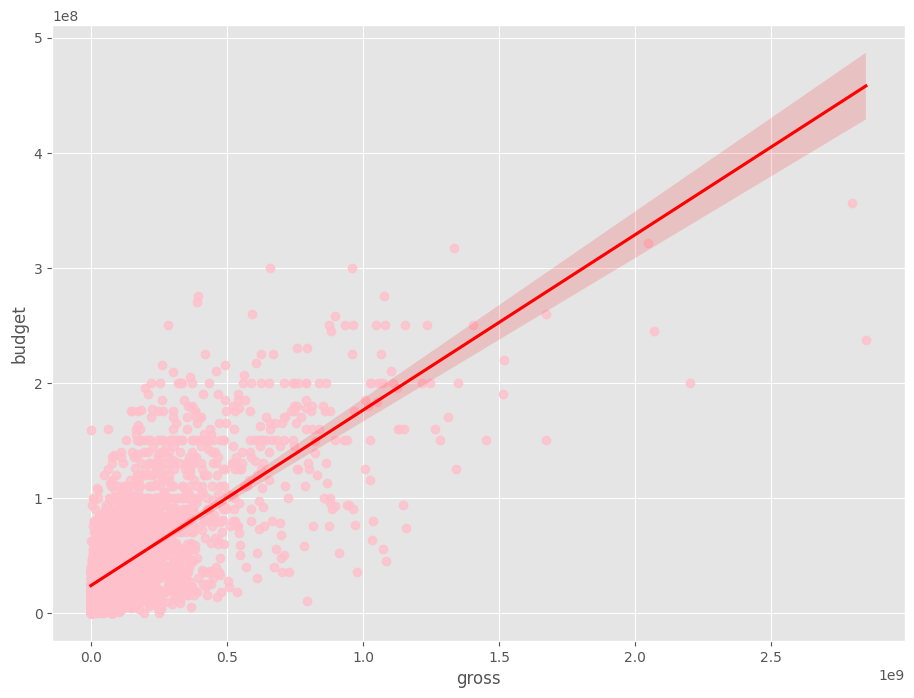

In [104]:
#Budget vs Gross Profit
sns.regplot(x="gross", y="budget", data=df,line_kws={'color':'red'},scatter_kws={'color':'pink'})

In [6]:
df.corr(method ='pearson',numeric_only = True)

,year,score,votes,budget,gross,runtime
year,1.000000,0.097995,0.222945,0.329321,0.257486,0.120811
score,0.097995,1.000000,0.409182,0.076254,0.186258,0.399451
votes,0.222945,0.409182,1.000000,0.442429,0.630757,0.309212
budget,0.329321,0.076254,0.442429,1.000000,0.740395,0.320447
gross,0.257486,0.186258,0.630757,0.740395,1.000000,0.245216
runtime,0.120811,0.399451,0.309212,0.320447,0.245216,1.000000


###### Proved : High correlation of 0.7 between gross profit and budget

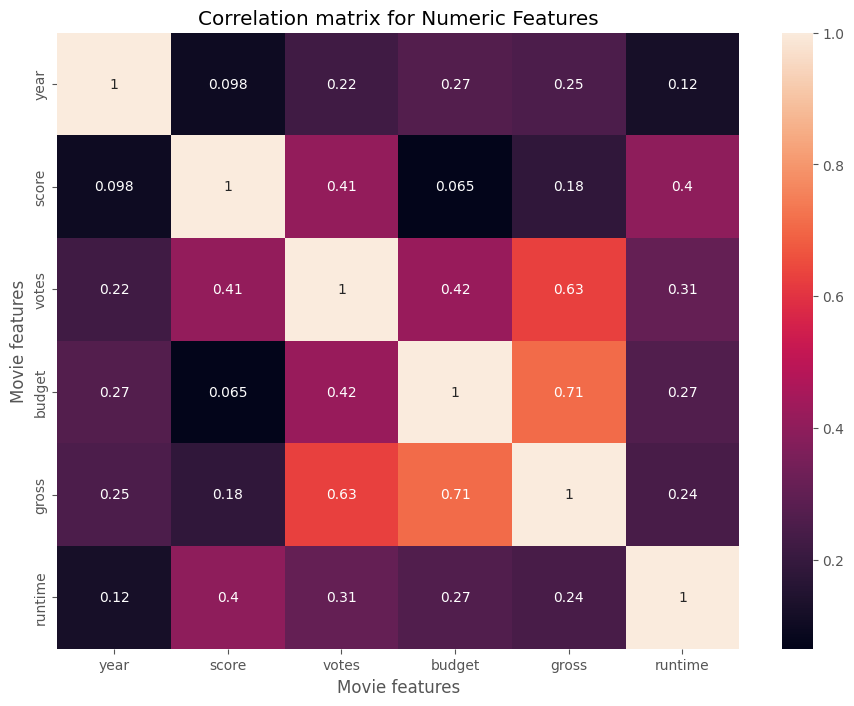

In [106]:
#Better Visualization
correlation_matrix = df.corr(numeric_only=True)

sns.heatmap(correlation_matrix, annot = True)
plt.title("Correlation matrix for Numeric Features")
plt.xlabel("Movie features")
plt.ylabel("Movie features")
plt.show()

#### Numeric/Categorical data correlation

In [135]:
#Changing data type of year and released to integer
df['year'] = df['year'].astype('int64')

In [179]:
#Changing data type of budget and gross
df['gross'] = pd.to_numeric(df['gross'], errors='coerce', downcast='integer')
df['budget'] = df['budget'].astype('int64')
df['gross'] = df['gross'].round().astype('int64')

In [139]:
df = df.drop(columns='released')

In [164]:
# Assigning numeric values to categorical valyes
df_numerized = df

for col_name in df_numerized.columns:
    if(df_numerized[col_name].dtype == 'object'):
        df_numerized[col_name]= df_numerized[col_name].astype('category')
        df_numerized[col_name] = df_numerized[col_name].cat.codes
        
df_numerized

,name,rating,genre,year,score,votes,director,writer,star,country,budget,gross,company,runtime
0,6587,6,6,1980,8.4,927000.0,2589,4014,1047,54,19000000,46998772,2319,146.0
1,5573,6,1,1980,5.8,65000.0,2269,1632,327,55,4500000,58853106,731,104.0
2,5142,4,0,1980,8.7,1200000.0,1111,2567,1745,55,18000000,538375067,1540,124.0
3,286,4,4,1980,7.7,221000.0,1301,2000,2246,55,3500000,83453539,1812,88.0
4,1027,6,4,1980,7.3,108000.0,1054,521,410,55,6000000,39846344,1777,98.0
5,2109,6,10,1980,6.4,123000.0,2528,4362,241,55,550000,39754601,1812,95.0
6,5574,6,0,1980,7.9,188000.0,1412,838,1277,55,27000000,115229890,2281,133.0
7,4436,6,3,1980,8.2,330000.0,1829,1769,2240,55,18000000,23402427,631,129.0
8,5281,4,0,1980,6.8,101000.0,2306,1979,877,55,54000000,108185706,883,127.0
9,6213,6,3,1980,7.0,10000.0,2864,423,589,55,10000000,15795189,2272,100.0


In [165]:
df_numerized.corr(method='pearson')

,name,rating,genre,year,score,votes,director,writer,star,country,budget,gross,company,runtime
name,1.000000,-0.008069,0.016355,0.011453,0.017097,0.013088,0.009079,0.009081,0.006472,-0.010737,0.020548,0.006989,0.009211,0.010392
rating,-0.008069,1.000000,0.072423,0.008779,-0.001314,0.033225,0.019483,-0.005921,0.013405,0.081244,-0.081939,-0.095450,-0.032943,0.062145
genre,0.016355,0.072423,1.000000,-0.081261,0.027965,-0.145307,-0.015258,0.006567,-0.005477,-0.037615,-0.334021,-0.234297,-0.071067,-0.052711
year,0.011453,0.008779,-0.081261,1.000000,0.097995,0.222945,-0.020795,-0.008656,-0.027242,-0.070938,0.309212,0.261900,-0.010431,0.120811
score,0.017097,-0.001314,0.027965,0.097995,1.000000,0.409182,0.009559,0.019416,-0.001609,-0.133348,0.055665,0.186392,0.001030,0.399451
votes,0.013088,0.033225,-0.145307,0.222945,0.409182,1.000000,0.000260,0.000892,-0.019282,0.073625,0.486862,0.632834,0.133204,0.309212
director,0.009079,0.019483,-0.015258,-0.020795,0.009559,0.000260,1.000000,0.299067,0.039234,0.017490,0.004976,-0.014916,0.004404,0.017624
writer,0.009081,-0.005921,0.006567,-0.008656,0.019416,0.000892,0.299067,1.000000,0.027245,0.015343,-0.025911,-0.022997,0.005646,-0.003511
star,0.006472,0.013405,-0.005477,-0.027242,-0.001609,-0.019282,0.039234,0.027245,1.000000,-0.012998,-0.019952,-0.001129,0.012442,0.010174
country,-0.010737,0.081244,-0.037615,-0.070938,-0.133348,0.073625,0.017490,0.015343,-0.012998,1.000000,0.131720,0.095325,0.095548,-0.078412


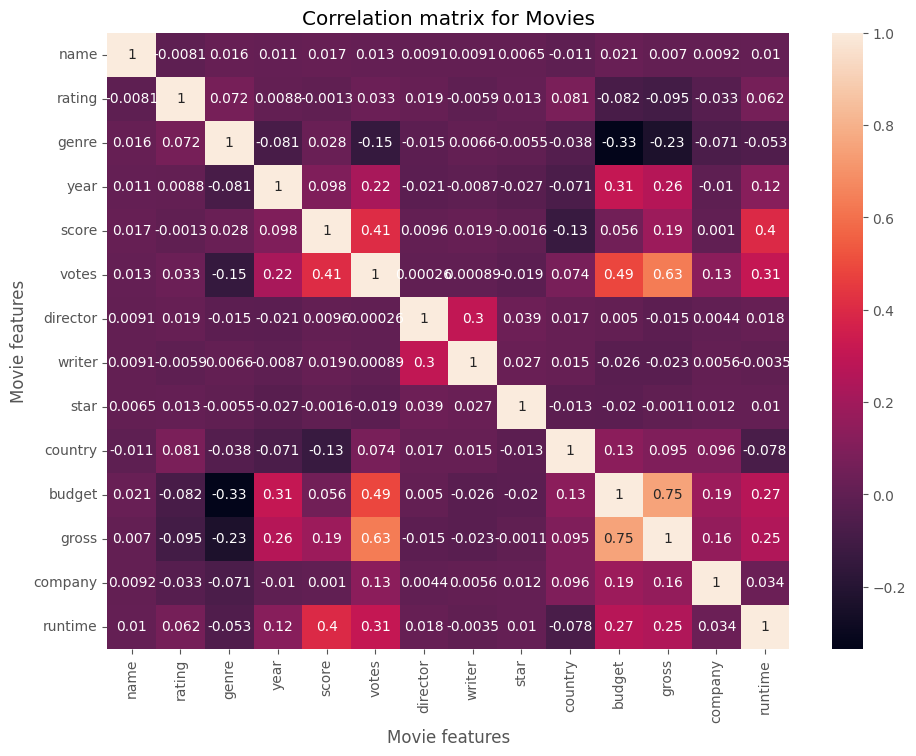

In [166]:
#Visualization
correlation_matrix = df_numerized.corr(method='pearson')
sns.heatmap(correlation_matrix, annot = True)
plt.title("Correlation matrix for Movies")
plt.xlabel("Movie features")
plt.ylabel("Movie features")

plt.show()

#### Highest Correlation between columns

In [170]:
# Pairing correlated pairs
correlation_mat = df_numerized.corr()
corr_pairs = correlation_mat.unstack()

corr_pairs

name      name        1.000000
          rating     -0.008069
          genre       0.016355
          year        0.011453
          score       0.017097
          votes       0.013088
          director    0.009079
          writer      0.009081
          star        0.006472
          country    -0.010737
          budget      0.020548
          gross       0.006989
          company     0.009211
          runtime     0.010392
rating    name       -0.008069
          rating      1.000000
          genre       0.072423
          year        0.008779
          score      -0.001314
          votes       0.033225
          director    0.019483
          writer     -0.005921
          star        0.013405
          country     0.081244
          budget     -0.081939
          gross      -0.095450
          company    -0.032943
          runtime     0.062145
genre     name        0.016355
          rating      0.072423
          genre       1.000000
          year       -0.081261
        

In [180]:
# Sorting correlated pairs on the basis of values 
sorted_pairs = corr_pairs.sort_values(kind='quicksort')

sorted_pairs

genre     budget     -0.334021
budget    genre      -0.334021
genre     gross      -0.234297
gross     genre      -0.234297
votes     genre      -0.145307
genre     votes      -0.145307
score     country    -0.133348
country   score      -0.133348
gross     rating     -0.095450
rating    gross      -0.095450
budget    rating     -0.081939
rating    budget     -0.081939
year      genre      -0.081261
genre     year       -0.081261
runtime   country    -0.078412
country   runtime    -0.078412
genre     company    -0.071067
company   genre      -0.071067
year      country    -0.070938
country   year       -0.070938
genre     runtime    -0.052711
runtime   genre      -0.052711
genre     country    -0.037615
country   genre      -0.037615
rating    company    -0.032943
company   rating     -0.032943
year      star       -0.027242
star      year       -0.027242
budget    writer     -0.025911
writer    budget     -0.025911
gross     writer     -0.022997
writer    gross      -0.022997
director

In [186]:
#Looking at pair that have high correlation (> 0.5) and are not same

strong_pairs = sorted_pairs[abs(sorted_pairs > 0.2) & abs(sorted_pairs < 1.0)]
strong_pairs

votes     year        0.222945
year      votes       0.222945
gross     runtime     0.245235
runtime   gross       0.245235
gross     year        0.261900
year      gross       0.261900
budget    runtime     0.269510
runtime   budget      0.269510
writer    director    0.299067
director  writer      0.299067
year      budget      0.309212
budget    year        0.309212
runtime   votes       0.309212
votes     runtime     0.309212
runtime   score       0.399451
score     runtime     0.399451
votes     score       0.409182
score     votes       0.409182
votes     budget      0.486862
budget    votes       0.486862
gross     votes       0.632834
votes     gross       0.632834
gross     budget      0.750157
budget    gross       0.750157
dtype: float64

## Conclusion

##### 1. Gross profit has the highest correlation with budget and votes 

##### 2. Company has low correlation with all the columns